In [ ]:
!sudo apt-get install -y fonts-nanum
!sudo fc-cache -fv
!rm ~/.cache/matplotlib -rf

Reading package lists... Done
Building dependency tree       
Reading state information... Done
The following package was automatically installed and is no longer required:
  libnvidia-common-460
Use 'sudo apt autoremove' to remove it.
The following NEW packages will be installed:
  fonts-nanum
0 upgraded, 1 newly installed, 0 to remove and 45 not upgraded.
Need to get 9,604 kB of archives.
After this operation, 29.5 MB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu bionic/universe amd64 fonts-nanum all 20170925-1 [9,604 kB]
Fetched 9,604 kB in 1s (16.0 MB/s)
debconf: unable to initialize frontend: Dialog
debconf: (No usable dialog-like program is installed, so the dialog based frontend cannot be used. at /usr/share/perl5/Debconf/FrontEnd/Dialog.pm line 76, <> line 1.)
debconf: falling back to frontend: Readline
debconf: unable to initialize frontend: Readline
debconf: (This frontend requires a controlling tty.)
debconf: falling back to frontend: Teletype

In [ ]:
import matplotlib.pyplot as plt

plt.rc('font', family='NanumBarunGothic') 

In [ ]:
import io
import pandas as pd

In [ ]:
city=pd.read_csv("경기주택도시공사_도시개발 현황_20220303.csv",encoding='cp949')
bus=pd.read_csv("버스정류소현황.csv",encoding='cp949')

In [ ]:
city.head()

,사업명,진행현황,공사위치,사업시행자,사업특징,면적 (제곱미터),수용세대,수용인구,사업시작(예정) 년월,사업종료(예정) 년월,웹페이지 주소(URL),위도,경도
0,남양주 다산신도시,NaN,남양주시 다산동 일원,GH,수도권 동북부 생활중심기능 수행,4749000.0,32115.0,82770.0,09-Dec,25-Dec,https://gh.or.kr/gh/business/detail.do?biId=41,37.620808,127.159574
1,광교신도시,사업준공 : 약 98%,수원시 원천동,"경기도지사, 수원시장, 용인시장, 경기주택도시공사 사장",친환경 자족형 신주거단지,11304494.0,31329.0,78323.0,15-Dec,23-Dec,https://gh.or.kr/gh/business/detail.do?biId=27,37.268454,127.062594
2,광교신도시,사업준공 : 약 99%,수원시 하동,"경기도지사, 수원시장, 용인시장, 경기주택도시공사 사장",친환경 자족형 신주거단지,11304494.0,31329.0,78323.0,15-Dec,23-Dec,https://gh.or.kr/gh/business/detail.do?biId=27,37.284685,127.057386
3,광교신도시,사업준공 : 약 99%,수원시 이의동,"경기도지사, 수원시장, 용인시장, 경기주택도시공사 사장",친환경 자족형 신주거단지,11304494.0,31329.0,78323.0,15-Dec,23-Dec,https://gh.or.kr/gh/business/detail.do?biId=27,37.287953,127.056567
4,광교신도시,사업준공 : 약 100%,용인시 상현동,"경기도지사, 수원시장, 용인시장, 경기주택도시공사 사장",친환경 자족형 신주거단지,11304494.0,31329.0,78323.0,15-Dec,23-Dec,https://gh.or.kr/gh/business/detail.do?biId=28,37.304806,127.074560


In [ ]:
city.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 44 entries, 0 to 43
Data columns (total 13 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   사업명           44 non-null     object 
 1   진행현황          40 non-null     object 
 2   공사위치          42 non-null     object 
 3   사업시행자         43 non-null     object 
 4   사업특징          43 non-null     object 
 5   면적 (제곱미터)     43 non-null     float64
 6   수용세대          43 non-null     float64
 7   수용인구          43 non-null     float64
 8   사업시작(예정) 년월   43 non-null     object 
 9   사업종료(예정) 년월   43 non-null     object 
 10  웹페이지 주소(URL)  43 non-null     object 
 11  위도            44 non-null     float64
 12  경도            44 non-null     float64
dtypes: float64(5), object(8)
memory usage: 4.6+ KB


In [ ]:
city1=city[["사업명","공사위치","면적 (제곱미터)","수용세대","수용인구","사업시작(예정) 년월","사업종료(예정) 년월","위도","경도"]]
city1.head()

,사업명,공사위치,면적 (제곱미터),수용세대,수용인구,사업시작(예정) 년월,사업종료(예정) 년월,위도,경도
0,남양주 다산신도시,남양주시 다산동 일원,4749000.0,32115.0,82770.0,09-Dec,25-Dec,37.620808,127.159574
1,광교신도시,수원시 원천동,11304494.0,31329.0,78323.0,15-Dec,23-Dec,37.268454,127.062594
2,광교신도시,수원시 하동,11304494.0,31329.0,78323.0,15-Dec,23-Dec,37.284685,127.057386
3,광교신도시,수원시 이의동,11304494.0,31329.0,78323.0,15-Dec,23-Dec,37.287953,127.056567
4,광교신도시,용인시 상현동,11304494.0,31329.0,78323.0,15-Dec,23-Dec,37.304806,127.074560


In [ ]:
city1["면적"]=city1["면적 (제곱미터)"]
city1["지역"]=city1["사업명"].str[0:2]#문자열 슬라이싱
city1["사업종료"]=city1["사업종료(예정) 년월"]
city1["사업시작"]=city["사업시작(예정) 년월"]
city1["사업시작"]=city1["사업시작"].str[0:2]
city1["사업종료"]=city1["사업종료"].str[0:2]

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documen

In [ ]:
city1.info()
city1.value_counts("사업시작")
city1=city1.astype({"사업시작":'float'})
city1=city1.astype({'사업종료':'float'})


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 44 entries, 0 to 43
Data columns (total 13 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   사업명          44 non-null     object 
 1   공사위치         42 non-null     object 
 2   면적 (제곱미터)    43 non-null     float64
 3   수용세대         43 non-null     float64
 4   수용인구         43 non-null     float64
 5   사업시작(예정) 년월  43 non-null     object 
 6   사업종료(예정) 년월  43 non-null     object 
 7   위도           44 non-null     float64
 8   경도           44 non-null     float64
 9   면적           43 non-null     float64
 10  지역           44 non-null     object 
 11  사업종료         43 non-null     object 
 12  사업시작         43 non-null     object 
dtypes: float64(6), object(7)
memory usage: 4.6+ KB


사업시작
19    14
20    11
08     8
15     5
16     2
09     1
18     1
21     1
dtype: int64

In [ ]:
city1=city1[["사업명","지역","공사위치","면적","수용세대","수용인구","위도","경도","사업시작","사업종료"]]
city1.head()

,사업명,지역,공사위치,면적,수용세대,수용인구,위도,경도,사업시작,사업종료
0,남양주 다산신도시,남양,남양주시 다산동 일원,4749000.0,32115.0,82770.0,37.620808,127.159574,9.0,25.0
1,광교신도시,광교,수원시 원천동,11304494.0,31329.0,78323.0,37.268454,127.062594,15.0,23.0
2,광교신도시,광교,수원시 하동,11304494.0,31329.0,78323.0,37.284685,127.057386,15.0,23.0
3,광교신도시,광교,수원시 이의동,11304494.0,31329.0,78323.0,37.287953,127.056567,15.0,23.0
4,광교신도시,광교,용인시 상현동,11304494.0,31329.0,78323.0,37.304806,127.074560,15.0,23.0


## EDA 및 점수산정

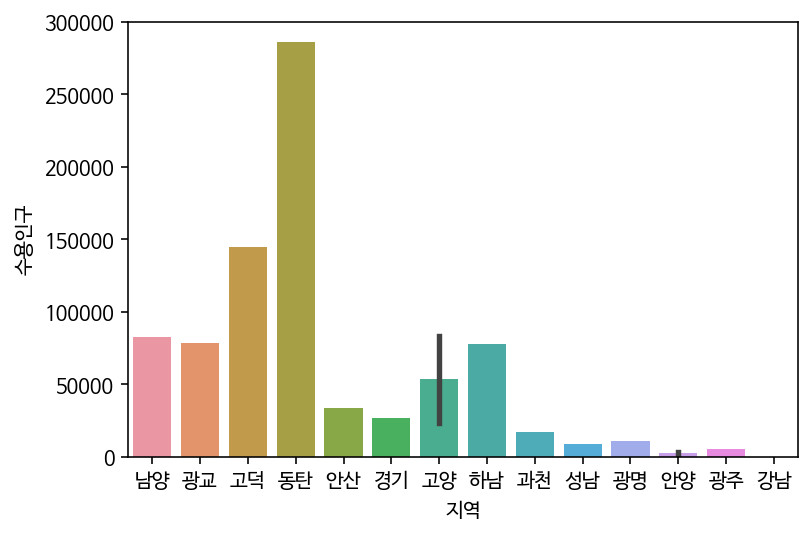

In [ ]:
sns.barplot(data=city1,x="지역",y="수용인구")

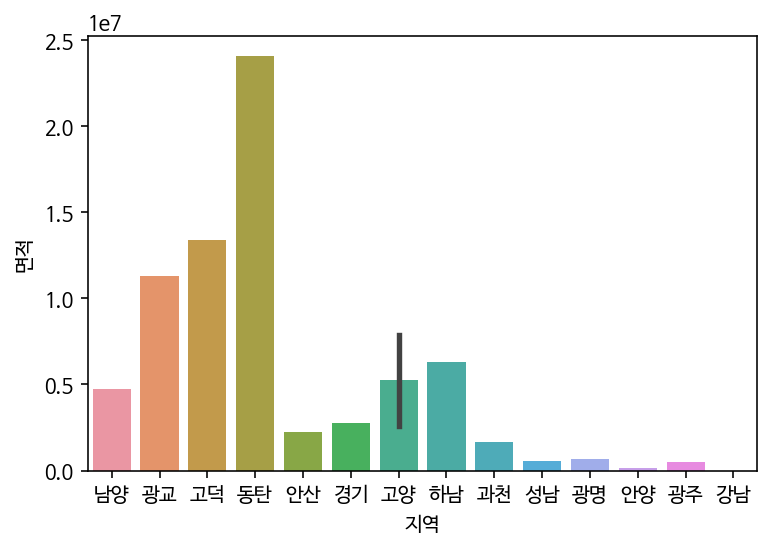

In [ ]:
sns.barplot(data=city1,x="지역",y="면적")

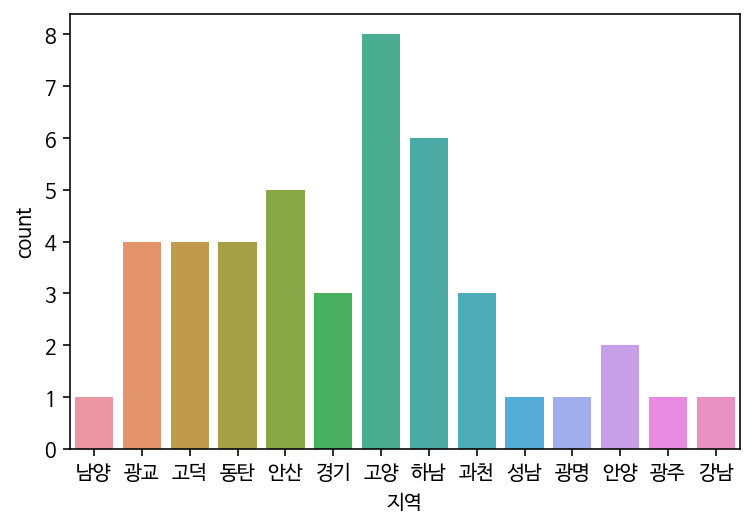

In [ ]:
sns.countplot(data=city1,x="지역")

In [ ]:
import folium

In [ ]:
m = folium.Map(location=[37.58, 127.0], tiles='openstreetmap', zoom_start=11)


In [ ]:
from folium import Marker
for _,row in city1.iterrows():
    Marker(location=[row['위도'],row['경도']],popup=row['사업명'],
           icon=folium.Icon(color='blue',icon='star')).add_to(m)
m

In [ ]:
from folium.plugins import MarkerCluster

In [ ]:
m = folium.Map(location=[37.58, 127.0], tiles='openstreetmap', zoom_start=11)
mc = MarkerCluster()
for _,row in city1.iterrows():
    mc.add_child(
        Marker(location=[row['위도'],row['경도']],popup=row['사업명']
              )
    )
m.add_child(mc)

In [ ]:
from folium.plugins import HeatMap
heatMap = HeatMap(zip(city1['위도'], city1['경도']),
                   min_opacity=0.1,
                   max_val=5,
                   radius=10, blur=15,
                   max_zoom=5)
m.add_child(heatMap)

m

In [ ]:
pip install geopandas

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 1.0 MB 4.8 MB/s 
     |████████████████████████████████| 6.3 MB 46.6 MB/s 
     |████████████████████████████████| 16.7 MB 48.7 MB/s 


In [ ]:
city1.shape

(44, 10)

In [ ]:
standard1=city1[city1["지역"]=="강남"]
city2=city1.drop(43,axis=0)
city2.tail()

,사업명,지역,공사위치,면적,수용세대,수용인구,위도,경도,사업시작,사업종료
38,안양 관양고 주변 도시개발사업,안양,안양시 동안구 관양동 521번지,157000.0,1345.0,3228.0,37.397185,126.978675,19.0,24.0
39,고양 일산테크노밸리,고양,고양시 일산서구 대화동,872000.0,53.0,131.0,37.676437,126.751228,16.0,24.0
40,고양 일산테크노밸리,고양,고양시 일산서구 법곳동,872000.0,53.0,131.0,37.668246,126.705420,16.0,24.0
41,고양 방송영상밸리,고양,고양시 일산동구 장항동,702000.0,3780.0,9299.0,37.645569,126.756051,19.0,23.0
42,광주역세권,광주,광주시 역동 169-15번지,489097.0,2303.0,5558.0,37.404300,127.252500,15.0,22.0


In [ ]:
city2["면적대비인구"]=city2["수용인구"]/city2["면적"]
city2

,사업명,지역,공사위치,면적,수용세대,수용인구,위도,경도,사업시작,사업종료,면적대비인구
0,남양주 다산신도시,남양,남양주시 다산동 일원,4749000.0,32115.0,82770.0,37.620808,127.159574,9.0,25.0,0.017429
1,광교신도시,광교,수원시 원천동,11304494.0,31329.0,78323.0,37.268454,127.062594,15.0,23.0,0.006928
2,광교신도시,광교,수원시 하동,11304494.0,31329.0,78323.0,37.284685,127.057386,15.0,23.0,0.006928
3,광교신도시,광교,수원시 이의동,11304494.0,31329.0,78323.0,37.287953,127.056567,15.0,23.0,0.006928
4,광교신도시,광교,용인시 상현동,11304494.0,31329.0,78323.0,37.304806,127.074560,15.0,23.0,0.006928
5,고덕국제신도시,고덕,평택시 고덕동,13360000.0,59530.0,144983.0,37.050568,127.044265,8.0,25.0,0.010852
6,고덕국제신도시,고덕,평택시 서정,13360000.0,59530.0,144983.0,37.060377,127.053809,8.0,25.0,0.010852
7,고덕국제신도시,고덕,평택시 지제,13360000.0,59530.0,144983.0,37.011444,127.087347,8.0,25.0,0.010852
8,고덕국제신도시,고덕,평택시 장당동,13360000.0,59530.0,144983.0,37.052124,127.062125,8.0,25.0,0.010852
9,동탄2신도시,동탄,화성시 동탄면 방교리,24039000.0,117295.0,285878.0,37.175049,127.103606,8.0,24.0,0.011892


In [ ]:
city4=city2[["사업명","면적대비인구"]]

In [ ]:
import geopandas as gpd

In [ ]:
city_distance = gpd.GeoDataFrame(city2, geometry=gpd.points_from_xy(city2.경도, city2.위도), crs='epsg:4326')
stadard_distance=gpd.GeoDataFrame(standard1, geometry=gpd.points_from_xy(standard1.경도, standard1.위도), crs='epsg:4326')

In [ ]:
city_distance

,사업명,지역,공사위치,면적,수용세대,수용인구,위도,경도,사업시작,사업종료,면적대비인구,geometry
0,남양주 다산신도시,남양,남양주시 다산동 일원,4749000.0,32115.0,82770.0,37.620808,127.159574,9.0,25.0,0.017429,POINT (127.15957 37.62081)
1,광교신도시,광교,수원시 원천동,11304494.0,31329.0,78323.0,37.268454,127.062594,15.0,23.0,0.006928,POINT (127.06259 37.26845)
2,광교신도시,광교,수원시 하동,11304494.0,31329.0,78323.0,37.284685,127.057386,15.0,23.0,0.006928,POINT (127.05739 37.28469)
3,광교신도시,광교,수원시 이의동,11304494.0,31329.0,78323.0,37.287953,127.056567,15.0,23.0,0.006928,POINT (127.05657 37.28795)
4,광교신도시,광교,용인시 상현동,11304494.0,31329.0,78323.0,37.304806,127.074560,15.0,23.0,0.006928,POINT (127.07456 37.30481)
5,고덕국제신도시,고덕,평택시 고덕동,13360000.0,59530.0,144983.0,37.050568,127.044265,8.0,25.0,0.010852,POINT (127.04427 37.05057)
6,고덕국제신도시,고덕,평택시 서정,13360000.0,59530.0,144983.0,37.060377,127.053809,8.0,25.0,0.010852,POINT (127.05381 37.06038)
7,고덕국제신도시,고덕,평택시 지제,13360000.0,59530.0,144983.0,37.011444,127.087347,8.0,25.0,0.010852,POINT (127.08735 37.01144)
8,고덕국제신도시,고덕,평택시 장당동,13360000.0,59530.0,144983.0,37.052124,127.062125,8.0,25.0,0.010852,POINT (127.06212 37.05212)
9,동탄2신도시,동탄,화성시 동탄면 방교리,24039000.0,117295.0,285878.0,37.175049,127.103606,8.0,24.0,0.011892,POINT (127.10361 37.17505)


In [ ]:
example_distances = city_distance.to_crs(epsg=5186).geometry.distance(stadard_distance.to_crs(epsg=5186).iloc[0].geometry)

In [ ]:
far = city_distance.iloc[example_distances.idxmax()]['사업명']
print(f'강남에서 가장 먼 지역:{far} 거리는({example_distances.max()} m)')

강남에서 가장 먼 지역:고덕국제신도시 거리는(54269.105427639355 m)


In [ ]:
result=pd.concat([city2["사업명"],example_distances],axis=1)

In [ ]:
result.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 43 entries, 0 to 42
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   사업명     43 non-null     object 
 1   0       43 non-null     float64
dtypes: float64(1), object(1)
memory usage: 1.0+ KB


In [ ]:
result.rename(columns={0:'거리'},inplace=True)

In [ ]:
distance=result.groupby(["사업명"]).mean()
distance.sort_values(['거리'],ascending=False)

,거리
사업명,
고덕국제신도시,50545.825995
동탄5신도시,38257.909482
동탄3신도시,36964.458696
동탄2신도시,36479.933062
동탄4신도시,36451.488205
고양 일산테크노밸리,32790.824612
고양 방송영상밸리,29041.580615
광교신도시,23705.078317
경기용인 플랫폼시티,23115.548297


In [ ]:
distance["거리정규화"]=(distance['거리']-distance['거리'].min())/(distance['거리'].max()-distance['거리'].min())
distance

,거리,거리정규화
사업명,,
경기용인 플랫폼시티,23115.548297,0.379104
고덕국제신도시,50545.825995,1.000000
고양 방송영상밸리,29041.580615,0.513242
고양 일산테크노밸리,32790.824612,0.598108
고양창릉 공공주택지구,18908.774155,0.283882
과천과천 공공주택지구,6367.284064,0.000000
광교신도시,23705.078317,0.392448
광명학온 공공주택지구,17565.518802,0.253477
광주역세권,22457.433920,0.364207


In [ ]:
distance["거리정규화"].describe()

count    19.000000
mean      0.407066
std       0.263778
min       0.000000
25%       0.231599
50%       0.364207
75%       0.639538
max       1.000000
Name: 거리정규화, dtype: float64

In [ ]:
distance["거리점수"]=1
distance.loc[(distance["거리정규화"]>=0.000000) & (distance["거리정규화"]<0.231266),"거리점수"]=1
distance.loc[(distance["거리정규화"]>=0.231266) & (distance["거리정규화"]<0.364207),"거리점수"]=1.5
distance.loc[(distance["거리정규화"]>=0.364207) & (distance["거리정규화"]<0.639538),"거리점수"]=2
distance.loc[(distance["거리정규화"]>=0.639538) & (distance["거리정규화"]<1.1),"거리점수"]=2.5
distance

,거리,거리정규화,거리점수
사업명,,,
경기용인 플랫폼시티,23115.548297,0.379104,2.0
고덕국제신도시,50545.825995,1.000000,2.5
고양 방송영상밸리,29041.580615,0.513242,2.0
고양 일산테크노밸리,32790.824612,0.598108,2.0
고양창릉 공공주택지구,18908.774155,0.283882,1.5
과천과천 공공주택지구,6367.284064,0.000000,1.0
광교신도시,23705.078317,0.392448,2.0
광명학온 공공주택지구,17565.518802,0.253477,1.5
광주역세권,22457.433920,0.364207,2.0


In [ ]:
subway=pd.read_csv("지하철 노선로.csv",encoding='cp949',header=3)
subway=subway.replace('-',0)
subway["행정구역"]=subway["행정구역"].str.replace(r"[^\w_]",r" ",regex=True)
subway["행정구역"]=subway["행정구역"].replace("_"," ",regex=True).str[1:5]
subway1=subway.iloc[1:]
subway1

,행정구역,철도역수,지하철_전철역수,전체역수,철도노선수,지하철_전철노선수,전체노선수
1,수원시,1,11,12,1,2,3
2,성남시,0,20,20,0,5,5
3,의정부시,1,6,7,1,2,3
4,안양시,1,7,8,1,2,3
5,부천시,1,11,12,1,2,3
6,광명시,1,3,4,1,2,3
7,평택시,4,5,9,3,1,4
8,동두천시,3,5,8,1,1,2
9,안산시,1,8,9,1,1,2
10,고양시,3,20,23,1,4,5


In [ ]:
new_city=["수원시 ","성남시 ","안양시 ","화성시 ","남양주시","고양시 "," 과천시 "," 광명시 ","용인시 ",'평택시 ','안산시 ','과천시 ','광명시 ','광주시 ','하남시 ']

In [ ]:
subway2 = subway1.loc[subway1['행정구역'].isin(new_city)]
subway2

,행정구역,철도역수,지하철_전철역수,전체역수,철도노선수,지하철_전철노선수,전체노선수
1,수원시,1,11,12,1,2,3
2,성남시,0,20,20,0,5,5
4,안양시,1,7,8,1,2,3
6,광명시,1,3,4,1,2,3
7,평택시,4,5,9,3,1,4
9,안산시,1,8,9,1,1,2
10,고양시,3,20,23,1,4,5
11,과천시,0,5,5,0,1,1
13,남양주시,4,12,16,2,2,4
18,용인시,0,6,6,0,1,1


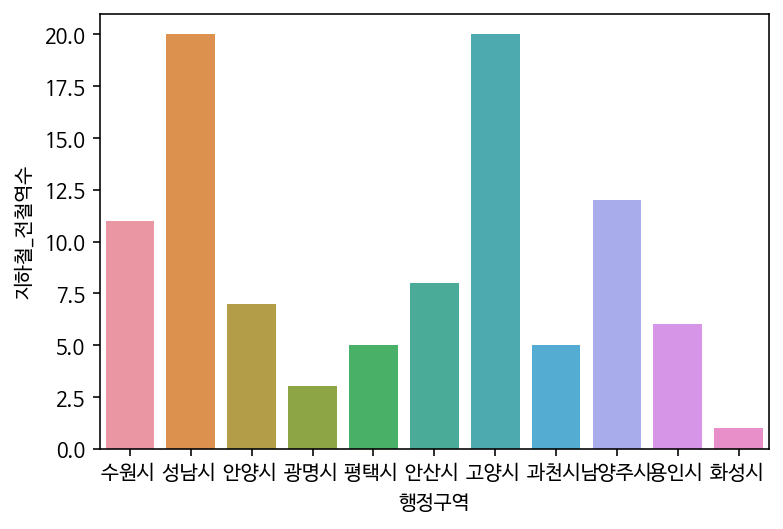

In [ ]:
sns.barplot(x="행정구역",y="지하철_전철역수",data=subway2)

In [ ]:
distance.info()

<class 'pandas.core.frame.DataFrame'>
Index: 19 entries, 경기용인 플랫폼시티 to 하남교산 공공주택지구
Data columns (total 3 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   거리      19 non-null     float64
 1   거리정규화   19 non-null     float64
 2   거리점수    19 non-null     float64
dtypes: float64(3)
memory usage: 608.0+ bytes


In [ ]:
distance["지하철역"]=1
distance.loc["경기용인 플랫폼시티",'지하철역']=6
distance.loc["고덕국제신도시",'지하철역']=5
distance.loc["고양 방송영상밸리",'지하철역']=20
distance.loc["고양 일산테크노밸리",'지하철역']=20
distance.loc["고양창릉 공공주택지구",'지하철역']=20
distance.loc["과천과천 공공주택지구",'지하철역']=5
distance.loc["광교신도시",'지하철역']=11
distance.loc["광명학온 공공주택지구",'지하철역']=4
distance.loc["광주역세권",'지하철역']=4
distance.loc["남양주 다산신도시",'지하철역']=4
distance.loc["동탄2신도시",'지하철역']=4
distance.loc["동탄3신도시",'지하철역']=4
distance.loc["동탄4신도시",'지하철역']=4
distance.loc["동탄5신도시",'지하철역']=4
distance.loc["성남금토(제3판교)",'지하철역']=20
distance.loc["안산장상 공공주택지구",'지하철역']=8
distance.loc["안양 관양고 주변 도시개발사업",'지하철역']=7
distance.loc["안양 인덕원 도시개발",'지하철역']=7
distance.loc["하남교산 공공주택지구",'지하철역']=6
distance

,거리,거리정규화,거리점수,지하철역
사업명,,,,
경기용인 플랫폼시티,23115.548297,0.379104,2.0,6
고덕국제신도시,50545.825995,1.000000,2.5,5
고양 방송영상밸리,29041.580615,0.513242,2.0,20
고양 일산테크노밸리,32790.824612,0.598108,2.0,20
고양창릉 공공주택지구,18908.774155,0.283882,1.5,20
과천과천 공공주택지구,6367.284064,0.000000,1.0,5
광교신도시,23705.078317,0.392448,2.0,11
광명학온 공공주택지구,17565.518802,0.253477,1.5,4
광주역세권,22457.433920,0.364207,2.0,4


In [ ]:
distance["지하철정규화"]=(distance['지하철역']-distance['지하철역'].min())/(distance['지하철역'].max()-distance['지하철역'].min())
distance.head()

,거리,거리정규화,거리점수,지하철역,지하철정규화
사업명,,,,,
경기용인 플랫폼시티,23115.548297,0.379104,2.0,6,0.1250
고덕국제신도시,50545.825995,1.000000,2.5,5,0.0625
고양 방송영상밸리,29041.580615,0.513242,2.0,20,1.0000
고양 일산테크노밸리,32790.824612,0.598108,2.0,20,1.0000
고양창릉 공공주택지구,18908.774155,0.283882,1.5,20,1.0000


In [ ]:
distance['지하철정규화'].describe()

count    19.000000
mean      0.286184
std       0.394909
min       0.000000
25%       0.000000
50%       0.125000
75%       0.343750
max       1.000000
Name: 지하철정규화, dtype: float64

In [ ]:
distance["지하철점수"]=1
distance.loc[(distance["지하철정규화"]>=0) & (distance["지하철정규화"]<0.1),"지하철점수"]=2.5
distance.loc[(distance["지하철정규화"]>=0.1) & (distance["지하철정규화"]<0.125),"지하철점수"]=2
distance.loc[(distance["지하철정규화"]>=0.125) & (distance["지하철정규화"]< 0.343750),"지하철점수"]=1.5
distance.loc[(distance["지하철정규화"]>= 0.343750) & (distance["지하철정규화"]<1.0001),"지하철점수"]=1
distance

,거리,거리정규화,거리점수,지하철역,지하철정규화,지하철점수
사업명,,,,,,
경기용인 플랫폼시티,23115.548297,0.379104,2.0,6,0.1250,1.5
고덕국제신도시,50545.825995,1.000000,2.5,5,0.0625,2.5
고양 방송영상밸리,29041.580615,0.513242,2.0,20,1.0000,1.0
고양 일산테크노밸리,32790.824612,0.598108,2.0,20,1.0000,1.0
고양창릉 공공주택지구,18908.774155,0.283882,1.5,20,1.0000,1.0
과천과천 공공주택지구,6367.284064,0.000000,1.0,5,0.0625,2.5
광교신도시,23705.078317,0.392448,2.0,11,0.4375,1.0
광명학온 공공주택지구,17565.518802,0.253477,1.5,4,0.0000,2.5
광주역세권,22457.433920,0.364207,2.0,4,0.0000,2.5


In [ ]:
bus=pd.read_csv("버스정류소현황.csv",encoding='cp949')
bus.drop_duplicates("정류소명",inplace=True)
bus.head()

,시군명,정류소명,정류소영문명,정류소id,정류소번호,중앙차로여부,관할관청,위치,WGS84위도,WGS84경도
0,가평군,3반상회앞,3-ban Market,239000307,44655.0,노변정류장,경기도 가평군,경기도 가평군 가평읍,37.811250,127.521467
1,가평군,가는골,Ganeungol,239000874,44847.0,노변정류장,경기도 가평군,경기도 가평군 북면,37.967533,127.418617
3,가평군,가둘기,Gadulgi,239000061,44280.0,노변정류장,경기도 가평군,경기도 가평군 북면,37.900067,127.511583
4,가평군,가둘기(목동방면),Gadulgi,239000459,44354.0,노변정류장,경기도 가평군,경기도 가평군 북면,37.900033,127.511700
5,가평군,가림마을,Garim Maeul,239000053,44286.0,노변정류장,경기도 가평군,경기도 가평군 북면,37.976683,127.443867


In [ ]:
bus_station=pd.DataFrame(bus["시군명"].value_counts())
bus_station

,시군명
화성시,1442
용인시,1409
고양시,1182
평택시,1012
파주시,981
수원시,913
남양주시,901
성남시,889
양주시,780
안산시,775


In [ ]:
distance["버스정류장수"]=1
distance.loc["경기용인 플랫폼시티",'버스정류장수']=1409
distance.loc["고덕국제신도시",'버스정류장수']=1012
distance.loc["고양 방송영상밸리",'버스정류장수']=1182
distance.loc["고양 일산테크노밸리",'버스정류장수']=1182
distance.loc["고양창릉 공공주택지구",'버스정류장수']=1182
distance.loc["과천과천 공공주택지구",'버스정류장수']=70
distance.loc["광교신도시",'버스정류장수']=913
distance.loc["광명학온 공공주택지구",'버스정류장수']=275
distance.loc["광주역세권",'버스정류장수']=635
distance.loc["남양주 다산신도시",'버스정류장수']=901
distance.loc["동탄2신도시",'버스정류장수']=1442
distance.loc["동탄3신도시",'버스정류장수']=1442
distance.loc["동탄4신도시",'버스정류장수']=1442
distance.loc["동탄5신도시",'버스정류장수']=1442
distance.loc["성남금토(제3판교)",'버스정류장수']=889
distance.loc["안산장상 공공주택지구",'버스정류장수']=775
distance.loc["안양 관양고 주변 도시개발사업",'버스정류장수']=416
distance.loc["안양 인덕원 도시개발",'버스정류장수']=416
distance.loc["하남교산 공공주택지구",'버스정류장수']=262
distance

,거리,거리정규화,거리점수,지하철역,지하철정규화,지하철점수,버스정류장수
사업명,,,,,,,
경기용인 플랫폼시티,23115.548297,0.379104,2.0,6,0.1250,1.5,1409
고덕국제신도시,50545.825995,1.000000,2.5,5,0.0625,2.5,1012
고양 방송영상밸리,29041.580615,0.513242,2.0,20,1.0000,1.0,1182
고양 일산테크노밸리,32790.824612,0.598108,2.0,20,1.0000,1.0,1182
고양창릉 공공주택지구,18908.774155,0.283882,1.5,20,1.0000,1.0,1182
과천과천 공공주택지구,6367.284064,0.000000,1.0,5,0.0625,2.5,70
광교신도시,23705.078317,0.392448,2.0,11,0.4375,1.0,913
광명학온 공공주택지구,17565.518802,0.253477,1.5,4,0.0000,2.5,275
광주역세권,22457.433920,0.364207,2.0,4,0.0000,2.5,635


In [ ]:
distance["버스정규화"]=(distance["버스정류장수"]-distance['버스정류장수'].min())/(distance['버스정류장수'].max()-distance['버스정류장수'].min())
distance.head()

,거리,거리정규화,거리점수,지하철역,지하철정규화,지하철점수,버스정류장수,버스정규화
사업명,,,,,,,,
경기용인 플랫폼시티,23115.548297,0.379104,2.0,6,0.1250,1.5,1409,0.975948
고덕국제신도시,50545.825995,1.000000,2.5,5,0.0625,2.5,1012,0.686589
고양 방송영상밸리,29041.580615,0.513242,2.0,20,1.0000,1.0,1182,0.810496
고양 일산테크노밸리,32790.824612,0.598108,2.0,20,1.0000,1.0,1182,0.810496
고양창릉 공공주택지구,18908.774155,0.283882,1.5,20,1.0000,1.0,1182,0.810496


In [ ]:
distance['버스정규화'].describe()

count    19.000000
mean      0.612130
std       0.331552
min       0.000000
25%       0.331997
50%       0.614431
75%       0.893222
max       1.000000
Name: 버스정규화, dtype: float64

In [ ]:
distance["버스점수"]=1
distance.loc[(distance["버스정규화"]>=0) & (distance["버스정규화"]<0.331997),"버스점수"]=2.5
distance.loc[(distance["버스정규화"]>=0.331997) & (distance["버스정규화"]<0.614431),"버스점수"]=2
distance.loc[(distance["버스정규화"]>=0.614431) & (distance["버스정규화"]<0.893222),"버스점수"]=1.5
distance.loc[(distance["버스정규화"]>=0.893222) & (distance["버스정규화"]<1.1),"버스점수"]=1
distance

,거리,거리정규화,거리점수,지하철역,지하철정규화,지하철점수,버스정류장수,버스정규화,버스점수
사업명,,,,,,,,,
경기용인 플랫폼시티,23115.548297,0.379104,2.0,6,0.1250,1.5,1409,0.975948,1.0
고덕국제신도시,50545.825995,1.000000,2.5,5,0.0625,2.5,1012,0.686589,1.5
고양 방송영상밸리,29041.580615,0.513242,2.0,20,1.0000,1.0,1182,0.810496,1.5
고양 일산테크노밸리,32790.824612,0.598108,2.0,20,1.0000,1.0,1182,0.810496,1.5
고양창릉 공공주택지구,18908.774155,0.283882,1.5,20,1.0000,1.0,1182,0.810496,1.5
과천과천 공공주택지구,6367.284064,0.000000,1.0,5,0.0625,2.5,70,0.000000,2.5
광교신도시,23705.078317,0.392448,2.0,11,0.4375,1.0,913,0.614431,1.5
광명학온 공공주택지구,17565.518802,0.253477,1.5,4,0.0000,2.5,275,0.149417,2.5
광주역세권,22457.433920,0.364207,2.0,4,0.0000,2.5,635,0.411808,2.0


In [ ]:
distance["면적대비인구비율"]=0
distance.loc["경기용인 플랫폼시티",'면적대비인구비율']=0.009788
distance.loc["고덕국제신도시",'면적대비인구비율']=0.010852
distance.loc["고양 방송영상밸리",'면적대비인구비율']=0.013246
distance.loc["고양 일산테크노밸리",'면적대비인구비율']=0.000150	
distance.loc["고양창릉 공공주택지구",'면적대비인구비율']=0.010556
distance.loc["과천과천 공공주택지구",'면적대비인구비율']=0.010215
distance.loc["광교신도시",'면적대비인구비율']= 0.006928
distance.loc["광명학온 공공주택지구",'면적대비인구비율']=0.015794
distance.loc["광주역세권",'면적대비인구비율']= 0.011364
distance.loc["남양주 다산신도시",'면적대비인구비율']=0.017429
distance.loc["동탄2신도시",'면적대비인구비율']=0.011892
distance.loc["동탄3신도시",'면적대비인구비율']=0.011892
distance.loc["동탄4신도시",'면적대비인구비율']=0.011892
distance.loc["동탄5신도시",'면적대비인구비율']=0.011892
distance.loc["성남금토(제3판교)",'면적대비인구비율']=0.015053
distance.loc["안산장상 공공주택지구",'면적대비인구비율']=0.015246
distance.loc["안양 관양고 주변 도시개발사업",'면적대비인구비율']= 0.020561
distance.loc["안양 인덕원 도시개발",'면적대비인구비율']=0.012934
distance.loc["하남교산 공공주택지구",'면적대비인구비율']=0.012342
distance

,거리,거리정규화,거리점수,지하철역,지하철정규화,지하철점수,버스정류장수,버스정규화,버스점수,면적대비인구비율
사업명,,,,,,,,,,
경기용인 플랫폼시티,23115.548297,0.379104,2.0,6,0.1250,1.5,1409,0.975948,1.0,0.009788
고덕국제신도시,50545.825995,1.000000,2.5,5,0.0625,2.5,1012,0.686589,1.5,0.010852
고양 방송영상밸리,29041.580615,0.513242,2.0,20,1.0000,1.0,1182,0.810496,1.5,0.013246
고양 일산테크노밸리,32790.824612,0.598108,2.0,20,1.0000,1.0,1182,0.810496,1.5,0.000150
고양창릉 공공주택지구,18908.774155,0.283882,1.5,20,1.0000,1.0,1182,0.810496,1.5,0.010556
과천과천 공공주택지구,6367.284064,0.000000,1.0,5,0.0625,2.5,70,0.000000,2.5,0.010215
광교신도시,23705.078317,0.392448,2.0,11,0.4375,1.0,913,0.614431,1.5,0.006928
광명학온 공공주택지구,17565.518802,0.253477,1.5,4,0.0000,2.5,275,0.149417,2.5,0.015794
광주역세권,22457.433920,0.364207,2.0,4,0.0000,2.5,635,0.411808,2.0,0.011364


In [ ]:
distance["면적대비인구비율정규화"]=(distance["면적대비인구비율"]-distance["면적대비인구비율"].min())/(distance['면적대비인구비율'].max()-distance['면적대비인구비율'].min())
distance["면적대비인구비율정규화"]

사업명
경기용인 플랫폼시티          0.472196
고덕국제신도시             0.524325
고양 방송영상밸리           0.641615
고양 일산테크노밸리          0.000000
고양창릉 공공주택지구         0.509823
과천과천 공공주택지구         0.493116
광교신도시               0.332076
광명학온 공공주택지구         0.766449
광주역세권               0.549410
남양주 다산신도시           0.846553
동탄2신도시              0.575278
동탄3신도시              0.575278
동탄4신도시              0.575278
동탄5신도시              0.575278
성남금토(제3판교)          0.730146
안산장상 공공주택지구         0.739601
안양 관양고 주변 도시개발사업    1.000000
안양 인덕원 도시개발         0.626329
하남교산 공공주택지구         0.597325
Name: 면적대비인구비율정규화, dtype: float64

In [ ]:
distance["면적대비인구비율점수"]=1
distance.loc[(distance["면적대비인구비율정규화"]>=0) & (distance["면적대비인구비율정규화"]<0.517074),"면적대비인구비율점수"]=1
distance.loc[(distance["면적대비인구비율정규화"]>=0.517074) & (distance["면적대비인구비율정규화"]<0.575278),"면적대비인구비율점수"]=1.5
distance.loc[(distance["면적대비인구비율정규화"]>=0.575278) & (distance["면적대비인구비율정규화"]<0.685880),"면적대비인구비율점수"]=2
distance.loc[(distance["면적대비인구비율정규화"]>=0.685880) & (distance["면적대비인구비율정규화"]<1.1),"면적대비인구비율점수"]=2.5
distance

,거리,거리정규화,거리점수,지하철역,지하철정규화,지하철점수,버스정류장수,버스정규화,버스점수,면적대비인구비율,면적대비인구비율정규화,면적대비인구비율점수
사업명,,,,,,,,,,,,
경기용인 플랫폼시티,23115.548297,0.379104,2.0,6,0.1250,1.5,1409,0.975948,1.0,0.009788,0.472196,1.0
고덕국제신도시,50545.825995,1.000000,2.5,5,0.0625,2.5,1012,0.686589,1.5,0.010852,0.524325,1.5
고양 방송영상밸리,29041.580615,0.513242,2.0,20,1.0000,1.0,1182,0.810496,1.5,0.013246,0.641615,2.0
고양 일산테크노밸리,32790.824612,0.598108,2.0,20,1.0000,1.0,1182,0.810496,1.5,0.000150,0.000000,1.0
고양창릉 공공주택지구,18908.774155,0.283882,1.5,20,1.0000,1.0,1182,0.810496,1.5,0.010556,0.509823,1.0
과천과천 공공주택지구,6367.284064,0.000000,1.0,5,0.0625,2.5,70,0.000000,2.5,0.010215,0.493116,1.0
광교신도시,23705.078317,0.392448,2.0,11,0.4375,1.0,913,0.614431,1.5,0.006928,0.332076,1.0
광명학온 공공주택지구,17565.518802,0.253477,1.5,4,0.0000,2.5,275,0.149417,2.5,0.015794,0.766449,2.5
광주역세권,22457.433920,0.364207,2.0,4,0.0000,2.5,635,0.411808,2.0,0.011364,0.549410,1.5


In [ ]:
minus=pd.read_csv("교통체증 정리.csv",encoding='cp949')
minus=minus.replace('-',0)
minus["행정구역"]=minus["행정구역"].str.replace(r"[^\w_]",r" ",regex=True)
minus["행정구역"]=minus["행정구역"].replace("_"," ",regex=True).str[1:5]
minus1=minus.iloc[1:]
minus1

,행정구역,오전(%),낮(%),오후(%),오전(%).1,낮(%).1,오후(%).1
1,수원시,11.5,4.2,30.1,1.7,4.9,4.5
2,성남시,8.0,7.3,19.0,3.4,8.0,5.3
3,의정부시,13.6,11.4,17.5,0.0,13.0,11.4
4,안양시,12.5,2.4,27.1,0.0,5.3,2.4
5,부천시,42.9,19.0,56.8,1.9,17.1,16.3
6,광명시,5.9,5.1,13.5,0.0,5.1,5.1
7,평택시,0.0,0.0,8.1,0.0,0.0,0.0
8,동두천시,2.1,4.2,4.2,0.0,4.2,4.2
9,안산시,2.5,0.0,3.7,0.0,6.4,0.2
10,고양시,7.6,6.0,14.5,1.8,7.3,7.8


In [ ]:
minus2 = minus1.loc[minus1['행정구역'].isin(new_city)]
minus2

,행정구역,오전(%),낮(%),오후(%),오전(%).1,낮(%).1,오후(%).1
1,수원시,11.5,4.2,30.1,1.7,4.9,4.5
2,성남시,8.0,7.3,19.0,3.4,8.0,5.3
4,안양시,12.5,2.4,27.1,0.0,5.3,2.4
6,광명시,5.9,5.1,13.5,0.0,5.1,5.1
7,평택시,0.0,0.0,8.1,0.0,0.0,0.0
9,안산시,2.5,0.0,3.7,0.0,6.4,0.2
10,고양시,7.6,6.0,14.5,1.8,7.3,7.8
11,과천시,4.9,0.0,9.3,0.0,0.0,0.0
13,남양주시,0.0,0.0,0.0,0.0,0.0,1.7
18,하남시,1.7,0.0,16.1,0.0,3.3,6.3


In [ ]:
minus3=minus2[["행정구역","오전(%)","오후(%)"]]
minus3["총합"]=minus3["오전(%)"]+minus3["오후(%)"]
minus3

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


,행정구역,오전(%),오후(%),총합
1,수원시,11.5,30.1,41.6
2,성남시,8.0,19.0,27.0
4,안양시,12.5,27.1,39.6
6,광명시,5.9,13.5,19.4
7,평택시,0.0,8.1,8.1
9,안산시,2.5,3.7,6.2
10,고양시,7.6,14.5,22.1
11,과천시,4.9,9.3,14.2
13,남양주시,0.0,0.0,0.0
18,하남시,1.7,16.1,17.8


In [ ]:
distance["교통체증퍼센트"]=1
distance.loc["경기용인 플랫폼시티",'교통체증퍼센트']=17.4
distance.loc["고덕국제신도시",'교통체증퍼센트']=8.1
distance.loc["고양 방송영상밸리",'교통체증퍼센트']=22.1
distance.loc["고양 일산테크노밸리",'교통체증퍼센트']=22.1
distance.loc["고양창릉 공공주택지구",'교통체증퍼센트']=22.1
distance.loc["과천과천 공공주택지구",'교통체증퍼센트']=14.2
distance.loc["광교신도시",'교통체증퍼센트']=41.6
distance.loc["광명학온 공공주택지구",'교통체증퍼센트']=19.4
distance.loc["광주역세권",'교통체증퍼센트']=10.5
distance.loc["남양주 다산신도시",'교통체증퍼센트']=0
distance.loc["동탄2신도시",'교통체증퍼센트']=13.1
distance.loc["동탄3신도시",'교통체증퍼센트']=13.1
distance.loc["동탄4신도시",'교통체증퍼센트']=13.1
distance.loc["동탄5신도시",'교통체증퍼센트']=13.1
distance.loc["성남금토(제3판교)",'교통체증퍼센트']=27
distance.loc["안산장상 공공주택지구",'교통체증퍼센트']=6.2
distance.loc["안양 관양고 주변 도시개발사업",'교통체증퍼센트']=39.6
distance.loc["안양 인덕원 도시개발",'교통체증퍼센트']=39.6
distance.loc["하남교산 공공주택지구",'교통체증퍼센트']=17.8
distance.head()

,거리,거리정규화,거리점수,지하철역,지하철정규화,지하철점수,버스정류장수,버스정규화,버스점수,면적대비인구비율,면적대비인구비율정규화,면적대비인구비율점수,교통체증퍼센트
사업명,,,,,,,,,,,,,
경기용인 플랫폼시티,23115.548297,0.379104,2.0,6,0.1250,1.5,1409,0.975948,1.0,0.009788,0.472196,1.0,17.4
고덕국제신도시,50545.825995,1.000000,2.5,5,0.0625,2.5,1012,0.686589,1.5,0.010852,0.524325,1.5,8.1
고양 방송영상밸리,29041.580615,0.513242,2.0,20,1.0000,1.0,1182,0.810496,1.5,0.013246,0.641615,2.0,22.1
고양 일산테크노밸리,32790.824612,0.598108,2.0,20,1.0000,1.0,1182,0.810496,1.5,0.000150,0.000000,1.0,22.1
고양창릉 공공주택지구,18908.774155,0.283882,1.5,20,1.0000,1.0,1182,0.810496,1.5,0.010556,0.509823,1.0,22.1


In [ ]:
distance['교통체증퍼센트정규화']=(distance['교통체증퍼센트']-distance['교통체증퍼센트'].min())/(distance['교통체증퍼센트'].max()-distance['교통체증퍼센트'].min())
distance['교통체증퍼센트정규화'].describe()

count    19.000000
mean      0.455592
std       0.273765
min       0.000000
25%       0.314904
50%       0.418269
75%       0.531250
max       1.000000
Name: 교통체증퍼센트정규화, dtype: float64

In [ ]:
distance["교통체증퍼센트 점수"]=1
distance.loc[(distance["교통체증퍼센트정규화"]>=0) & (distance["교통체증퍼센트정규화"]<0.314904),"교통체증퍼센트 점수"]=1
distance.loc[(distance["교통체증퍼센트정규화"]>=0.314904) & (distance["교통체증퍼센트정규화"]<0.418269),"교통체증퍼센트 점수"]=1.5
distance.loc[(distance["교통체증퍼센트정규화"]>=0.418269) & (distance["교통체증퍼센트정규화"]<0.531250),"교통체증퍼센트 점수"]=2
distance.loc[(distance["교통체증퍼센트정규화"]>=0.531250) & (distance["교통체증퍼센트정규화"]<1.1),"교통체증퍼센트 점수"]=2.5
distance

,거리,거리정규화,거리점수,지하철역,지하철정규화,지하철점수,버스정류장수,버스정규화,버스점수,면적대비인구비율,면적대비인구비율정규화,면적대비인구비율점수,교통체증퍼센트,교통체증퍼센트정규화,교통체증퍼센트 점수
사업명,,,,,,,,,,,,,,,
경기용인 플랫폼시티,23115.548297,0.379104,2.0,6,0.1250,1.5,1409,0.975948,1.0,0.009788,0.472196,1.0,17.4,0.418269,2.0
고덕국제신도시,50545.825995,1.000000,2.5,5,0.0625,2.5,1012,0.686589,1.5,0.010852,0.524325,1.5,8.1,0.194712,1.0
고양 방송영상밸리,29041.580615,0.513242,2.0,20,1.0000,1.0,1182,0.810496,1.5,0.013246,0.641615,2.0,22.1,0.531250,2.5
고양 일산테크노밸리,32790.824612,0.598108,2.0,20,1.0000,1.0,1182,0.810496,1.5,0.000150,0.000000,1.0,22.1,0.531250,2.5
고양창릉 공공주택지구,18908.774155,0.283882,1.5,20,1.0000,1.0,1182,0.810496,1.5,0.010556,0.509823,1.0,22.1,0.531250,2.5
과천과천 공공주택지구,6367.284064,0.000000,1.0,5,0.0625,2.5,70,0.000000,2.5,0.010215,0.493116,1.0,14.2,0.341346,1.5
광교신도시,23705.078317,0.392448,2.0,11,0.4375,1.0,913,0.614431,1.5,0.006928,0.332076,1.0,41.6,1.000000,2.5
광명학온 공공주택지구,17565.518802,0.253477,1.5,4,0.0000,2.5,275,0.149417,2.5,0.015794,0.766449,2.5,19.4,0.466346,2.0
광주역세권,22457.433920,0.364207,2.0,4,0.0000,2.5,635,0.411808,2.0,0.011364,0.549410,1.5,10.5,0.252404,1.0


In [ ]:
distance.info()

<class 'pandas.core.frame.DataFrame'>
Index: 19 entries, 경기용인 플랫폼시티 to 하남교산 공공주택지구
Data columns (total 15 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   거리           19 non-null     float64
 1   거리정규화        19 non-null     float64
 2   거리점수         19 non-null     float64
 3   지하철역         19 non-null     int64  
 4   지하철정규화       19 non-null     float64
 5   지하철점수        19 non-null     float64
 6   버스정류장수       19 non-null     int64  
 7   버스정규화        19 non-null     float64
 8   버스점수         19 non-null     float64
 9   면적대비인구비율     19 non-null     float64
 10  면적대비인구비율정규화  19 non-null     float64
 11  면적대비인구비율점수   19 non-null     float64
 12  교통체증퍼센트      19 non-null     float64
 13  교통체증퍼센트정규화   19 non-null     float64
 14  교통체증퍼센트 점수   19 non-null     float64
dtypes: float64(13), int64(2)
memory usage: 2.9+ KB


#최종점수

In [ ]:
distance["점수"]=distance["거리점수"]+distance["지하철점수"]+distance["버스점수"]+distance["면적대비인구비율점수"]+distance['교통체증퍼센트 점수']
distance

,거리,거리정규화,거리점수,지하철역,지하철정규화,지하철점수,버스정류장수,버스정규화,버스점수,면적대비인구비율,면적대비인구비율정규화,면적대비인구비율점수,교통체증퍼센트,교통체증퍼센트정규화,교통체증퍼센트 점수,점수
사업명,,,,,,,,,,,,,,,,
경기용인 플랫폼시티,23115.548297,0.379104,2.0,6,0.1250,1.5,1409,0.975948,1.0,0.009788,0.472196,1.0,17.4,0.418269,2.0,7.5
고덕국제신도시,50545.825995,1.000000,2.5,5,0.0625,2.5,1012,0.686589,1.5,0.010852,0.524325,1.5,8.1,0.194712,1.0,9.0
고양 방송영상밸리,29041.580615,0.513242,2.0,20,1.0000,1.0,1182,0.810496,1.5,0.013246,0.641615,2.0,22.1,0.531250,2.5,9.0
고양 일산테크노밸리,32790.824612,0.598108,2.0,20,1.0000,1.0,1182,0.810496,1.5,0.000150,0.000000,1.0,22.1,0.531250,2.5,8.0
고양창릉 공공주택지구,18908.774155,0.283882,1.5,20,1.0000,1.0,1182,0.810496,1.5,0.010556,0.509823,1.0,22.1,0.531250,2.5,7.5
과천과천 공공주택지구,6367.284064,0.000000,1.0,5,0.0625,2.5,70,0.000000,2.5,0.010215,0.493116,1.0,14.2,0.341346,1.5,8.5
광교신도시,23705.078317,0.392448,2.0,11,0.4375,1.0,913,0.614431,1.5,0.006928,0.332076,1.0,41.6,1.000000,2.5,8.0
광명학온 공공주택지구,17565.518802,0.253477,1.5,4,0.0000,2.5,275,0.149417,2.5,0.015794,0.766449,2.5,19.4,0.466346,2.0,11.0
광주역세권,22457.433920,0.364207,2.0,4,0.0000,2.5,635,0.411808,2.0,0.011364,0.549410,1.5,10.5,0.252404,1.0,9.0


광명신도시가 점수가 높으므로 임시 지역 설치

# 광명신도시 정거장 설치

In [ ]:
bus_km=bus.loc[bus['시군명']=="광명시",:]
bus_km.reset_index(inplace=True)
bus_km=bus_km[["시군명","WGS84위도","WGS84경도","정류소명"]]
bus_km.rename(columns={"WGS84위도":"위도","WGS84경도":'경도'},inplace=True)
bus_km.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 275 entries, 0 to 274
Data columns (total 4 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   시군명     275 non-null    object 
 1   위도      275 non-null    float64
 2   경도      275 non-null    float64
 3   정류소명    275 non-null    object 
dtypes: float64(2), object(2)
memory usage: 8.7+ KB


In [ ]:
city_km=city2.loc[city2["지역"]=="광명",:]
city_km

,사업명,지역,공사위치,면적,수용세대,수용인구,위도,경도,사업시작,사업종료,면적대비인구,geometry
36,광명학온 공공주택지구,광명,경기도 광명시 가학동,683475.0,5007.0,10795.0,37.411538,126.861403,20.0,26.0,0.015794,POINT (126.86140 37.41154)


In [ ]:
import folium
m = folium.Map(location=[37.58, 127.0], tiles='openstreetmap', zoom_start=11)
for _,row in bus_km.iterrows():
  Marker(location = [row['위도'], row['경도']],
           popup=row['정류소명'],
           icon=folium.Icon(color='blue',icon='star')
          ).add_to(m)
m


In [ ]:
for _,row in city_km.iterrows():
  Marker(location = [row['위도'], row['경도']],
           popup=row['사업명'],
           icon=folium.Icon(color='red',icon='star')
          ).add_to(m)
m

In [ ]:
bus_km_gdf = gpd.GeoDataFrame(bus_km, geometry=gpd.points_from_xy(bus_km.경도, bus_km.위도), crs='epsg:4326')
city_km_gdf = gpd.GeoDataFrame(city_km, geometry=gpd.points_from_xy(city_km.경도, city_km.위도), crs='epsg:4326')
bus_km_gdf

,시군명,위도,경도,정류소명,geometry
0,광명시,37.463500,126.833000,KG케미칼,POINT (126.83300 37.46350)
1,광명시,37.416467,126.883733,KTX광명역.셔틀버스(지하),POINT (126.88373 37.41647)
2,광명시,37.415433,126.885517,KTX광명역.파크자이1차,POINT (126.88552 37.41543)
3,광명시,37.417750,126.884400,KTX광명역1번출구,POINT (126.88440 37.41775)
4,광명시,37.416983,126.884017,KTX광명역2번출구,POINT (126.88402 37.41698)
...,...,...,...,...,...
270,광명시,37.476600,126.845983,현진월드아파트,POINT (126.84598 37.47660)
271,광명시,37.482733,126.866050,현충탑입구.철산종합사회복지관,POINT (126.86605 37.48273)
272,광명시,37.418383,126.880050,호봉골,POINT (126.88005 37.41838)
273,광명시,37.467817,126.849150,화영운수차고지,POINT (126.84915 37.46782)


In [ ]:
example=bus_km_gdf.to_crs(epsg=5186).geometry.distance(city_km_gdf.to_crs(epsg=5186).iloc[0].geometry)
example

0      6291.056607
1      2051.119252
2      2178.062371
3      2149.408661
4      2091.147377
          ...     
270    7348.776717
271    7912.390899
272    1817.176945
273    6339.579271
274    6348.590637
Length: 275, dtype: float64

In [ ]:
min = bus_km.iloc[example.idxmin()]['정류소명']
print(f'산도시에서 가장 가까운 지역:{min} 거리는({example.min()} m)')

산도시에서 가장 가까운 지역:공세동 거리는(103.42941637635798 m)


In [ ]:
two_hundred_buffer = bus_km_gdf.to_crs(epsg=5186).geometry.buffer(2*100)

In [ ]:
pip install GeoJson

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
import geojson


In [ ]:
 from socket import socket

In [ ]:
from folium import CircleMarker

In [ ]:
import folium
m = folium.Map(location=[37.58, 127.0], tiles='openstreetmap', zoom_start=10)
for _,row in bus_km.iterrows():
  CircleMarker(location = [row['위도'], row['경도']],
           popup=row['정류소명'],
           icon=folium.Icon(color='blue',icon='star'),
           radius=200
          ).add_to(m)
m


In [ ]:
for _,row in bus_km.iterrows():
  Marker(location = [row['위도'], row['경도']],
           popup=row['정류소명'],
           icon=folium.Icon(color='blue',icon='star')
          ).add_to(m)
m


In [ ]:
for _,row in city_km.iterrows():
  CircleMarker(location = [row['위도'], row['경도']],
           popup=row['사업명'],
           color='red',
           radius=200
          ).add_to(m)
m

In [ ]:
for _,row in city_km.iterrows():
  Marker(location = [row['위도'], row['경도']],
           popup=row['사업명'],
           icon=folium.Icon(color='red',icon='star')
          ).add_to(m)
m

#신도시 지어진곳 동탄 신도시

In [ ]:
bus_hs=bus.loc[bus['시군명']=="화성시",:]
bus_hs.reset_index(inplace=True)
bus_hs=bus_hs[["시군명","WGS84위도","WGS84경도","정류소명"]]
bus_hs.rename(columns={"WGS84위도":"위도","WGS84경도":'경도'},inplace=True)
bus_hs.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1442 entries, 0 to 1441
Data columns (total 4 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   시군명     1442 non-null   object 
 1   위도      1442 non-null   float64
 2   경도      1442 non-null   float64
 3   정류소명    1442 non-null   object 
dtypes: float64(2), object(2)
memory usage: 45.2+ KB


In [ ]:
city_hs=city2.loc[city2["지역"]=="동탄",:]
city_hs

,사업명,지역,공사위치,면적,수용세대,수용인구,위도,경도,사업시작,사업종료,면적대비인구,geometry
9,동탄2신도시,동탄,화성시 동탄면 방교리,24039000.0,117295.0,285878.0,37.175049,127.103606,8.0,24.0,0.011892,POINT (127.10361 37.17505)
10,동탄3신도시,동탄,화성시 동탄면 산척리,24039000.0,117295.0,285878.0,37.171669,127.110452,8.0,24.0,0.011892,POINT (127.11045 37.17167)
11,동탄4신도시,동탄,화성시 동탄면 송리,24039000.0,117295.0,285878.0,37.175310,127.103603,8.0,24.0,0.011892,POINT (127.10360 37.17531)
12,동탄5신도시,동탄,화성시 동탄면 장지리,24039000.0,117295.0,285878.0,37.159150,127.106269,8.0,24.0,0.011892,POINT (127.10627 37.15915)


In [ ]:
bus_hs_gdf = gpd.GeoDataFrame(bus_hs, geometry=gpd.points_from_xy(bus_hs.경도, bus_hs.위도), crs='epsg:4326')
city_hs_gdf = gpd.GeoDataFrame(city_hs, geometry=gpd.points_from_xy(city_hs.경도, city_hs.위도), crs='epsg:4326')
bus_hs_gdf

,시군명,위도,경도,정류소명,geometry
0,화성시,37.108317,126.839367,3M,POINT (126.83937 37.10832)
1,화성시,37.250967,126.920867,51사단,POINT (126.92087 37.25097)
2,화성시,37.160050,127.120017,A100,POINT (127.12002 37.16005)
3,화성시,37.190183,127.124550,A44,POINT (127.12455 37.19018)
4,화성시,37.166800,127.106950,A73.업무복합,POINT (127.10695 37.16680)
...,...,...,...,...,...
1437,화성시,37.123500,126.913417,휴먼시아5.6블럭,POINT (126.91342 37.12350)
1438,화성시,37.164950,126.734033,흥법리마을회관,POINT (126.73403 37.16495)
1439,화성시,37.166583,126.740150,흥법리모래지,POINT (126.74015 37.16658)
1440,화성시,37.200050,126.980350,흥법사입구,POINT (126.98035 37.20005)


In [ ]:
example_distances = bus_hs_gdf.to_crs(epsg=5186).geometry.distance(city_hs_gdf.to_crs(epsg=5186).iloc[0].geometry)
cloest_bus = bus_hs.iloc[example_distances.idxmin()]['정류소명']
cloest_bus




'LH65블럭.하우스디더레이크.나래학교'

In [ ]:
import folium
m = folium.Map(location=[37.58, 127.0], tiles='openstreetmap', zoom_start=10)
for _,row in bus_hs.iterrows():
  Marker(location = [row['위도'], row['경도']],
           popup=row['정류소명'],
           icon=folium.Icon(color='blue',icon='star')
          ).add_to(m)
m

In [ ]:
for _,row in city_hs.iterrows():
  CircleMarker(location = [row['위도'], row['경도']],
           popup=row['지역'],
           color='red',
           radius=200
          ).add_to(m)
m

In [ ]:
for _,row in city_hs.iterrows():
  Marker(location = [row['위도'], row['경도']],
           popup=row['사업명'],
           icon=folium.Icon(color='red',icon='star')
          ).add_to(m)
m

In [ ]:
for _,row in bus_hs.iterrows():
  CircleMarker(location = [row['위도'], row['경도']],
           popup=row['정류소명'],
           icon=folium.Icon(color='blue',icon='star'),
           radius=200
          ).add_to(m)
m

# 다산 신도시 버스정류장 간이정류장 선정

In [ ]:
bus_ny=bus.loc[bus['시군명']=="남양주시",:]
bus_ny.reset_index(inplace=True)
bus_ny=bus_ny[["시군명","WGS84위도","WGS84경도","정류소명"]]
bus_ny.rename(columns={"WGS84위도":"위도","WGS84경도":'경도'},inplace=True)
bus_ny.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 901 entries, 0 to 900
Data columns (total 4 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   시군명     901 non-null    object 
 1   위도      901 non-null    float64
 2   경도      901 non-null    float64
 3   정류소명    901 non-null    object 
dtypes: float64(2), object(2)
memory usage: 28.3+ KB


In [ ]:
city_ny=city2.loc[city2["지역"]=="남양",:]
city_ny

,사업명,지역,공사위치,면적,수용세대,수용인구,위도,경도,사업시작,사업종료,면적대비인구,geometry
0,남양주 다산신도시,남양,남양주시 다산동 일원,4749000.0,32115.0,82770.0,37.620808,127.159574,9.0,25.0,0.017429,POINT (127.15957 37.62081)


In [ ]:
bus_ny_gdf = gpd.GeoDataFrame(bus_ny, geometry=gpd.points_from_xy(bus_ny.경도, bus_ny.위도), crs='epsg:4326')
city_ny_gdf = gpd.GeoDataFrame(city_ny, geometry=gpd.points_from_xy(city_ny.경도, city_ny.위도), crs='epsg:4326')
bus_ny_gdf

,시군명,위도,경도,정류소명,geometry
0,남양주시,37.708317,127.114533,1단지.2단지.6단지.7단지,POINT (127.11453 37.70832)
1,남양주시,37.646533,127.108883,202번종점,POINT (127.10888 37.64653)
2,남양주시,37.739333,127.223133,75사단입구,POINT (127.22313 37.73933)
3,남양주시,37.682400,127.305067,88주택,POINT (127.30507 37.68240)
4,남양주시,37.655867,127.117733,KCC스위첸아파트,POINT (127.11773 37.65587)
...,...,...,...,...,...
896,남양주시,37.599083,127.157400,휴먼시아6.7단지.가운중학교,POINT (127.15740 37.59908)
897,남양주시,37.597833,127.159067,휴먼시아6.8단지,POINT (127.15907 37.59783)
898,남양주시,37.725133,127.208233,휴먼시아아파트,POINT (127.20823 37.72513)
899,남양주시,37.729317,127.194183,휴먼시아아파트.진접도서관,POINT (127.19418 37.72932)


In [ ]:
example=bus_ny_gdf.to_crs(epsg=5186).geometry.distance(city_ny_gdf.to_crs(epsg=5186).iloc[0].geometry)
example

0      10494.148245
1       5307.724755
2      14300.190465
3      14545.785744
4       5364.580735
           ...     
896     2418.850732
897     2550.353659
898    12349.262541
899    12424.435172
900     3311.290339
Length: 901, dtype: float64

In [ ]:
min = bus_ny.iloc[example.idxmin()]['정류소명']
print(f'산도시에서 가장 가까운 지역:{min} 거리는({example.min()} m)')

산도시에서 가장 가까운 지역:대림아파트 거리는(181.40413166544826 m)


In [ ]:
import folium
m = folium.Map(location=[37.58, 127.0], tiles='openstreetmap', zoom_start=10)
for _,row in bus_ny.iterrows():
  CircleMarker(location = [row['위도'], row['경도']],
           popup=row['정류소명'],
           icon=folium.Icon(color='blue',icon='star'),
           radius=200
          ).add_to(m)
m


In [ ]:
for _,row in bus_ny.iterrows():
  Marker(location = [row['위도'], row['경도']],
           popup=row['정류소명'],
           icon=folium.Icon(color='blue',icon='star')
          ).add_to(m)
m

In [ ]:
for _,row in city_ny.iterrows():
  Marker(location = [row['위도'], row['경도']],
           popup=row['사업명'],
           icon=folium.Icon(color='red',icon='star')
          ).add_to(m)
m

In [ ]:
for _,row in city_ny.iterrows():
  CircleMarker(location = [row['위도'], row['경도']],
           popup=row['지역'],
           color='red',
           radius=200
          ).add_to(m)
m